In [1]:
import pandas as pd
import numpy as np
df = pd.read_json("250k.docs.jsonl", lines=True)

In [3]:
papers = df[(df.DocType == "Journal") | (df.DocType == "Conference")]

papers["FirstPage"] = papers.FirstPage.apply(lambda x: x.split("-")[-1] if x else np.nan)
papers["LastPage"] = papers.LastPage.apply(lambda x: x.split("-")[-1] if x else np.nan)
papers["Length"] = pd.to_numeric(papers.LastPage) - pd.to_numeric(papers.FirstPage)

papers = papers.drop(columns=["Urls", "PdfUrl", "Doi", "Volume", "Issue", "FirstPage", "LastPage", "BookTitle", "PaperId"])

In [16]:
authors = dict()
for i, row in papers.iterrows():
    for entry in row.Authors:
        _id = entry["AuthorId"]
        if _id not in authors:
            authors[_id] = 1
        else:
            authors[_id] += 1

In [5]:
majors = []
minors = []
journals = []
for i, row in papers.iterrows():
    major_fields = []
    minor_fields = []
    journal_entry = row.Journal
    for entry in row.FieldsOfStudy:
        level = entry["Level"]
        name = entry["Name"]
        if level == 0:
            major_fields.append(name)
        elif level == 1:
            minor_fields.append(name)
    majors.append(major_fields)
    minors.append(minor_fields)
    journals.append(journal_entry["JournalName"] if journal_entry else np.nan)
    
papers["MajorFields"] = majors
papers["MinorFields"] = minors
papers["Journal"] = journals

In [7]:
papers = papers.drop(columns=["FieldsOfStudy", "PublishedDate"])[papers.MajorFields.apply(lambda x: len(x)) == 1]

Author Citation Count/Mean/Highest per entry

In [20]:
authors = pd.Series(authors)

<AxesSubplot:>

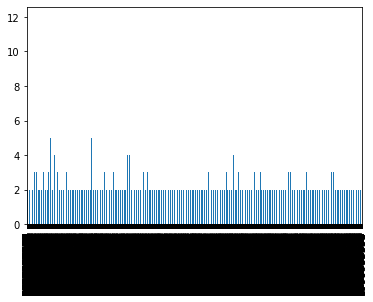

In [25]:
authors[authors != 1].plot.bar()

In [24]:
authors

2632896860    1
2708987407    1
2112951595    1
2288764707    3
2607684002    1
             ..
2764849508    1
2889184791    1
25946571      1
2647108314    1
2628109240    1
Length: 532589, dtype: int64